In [1]:
import numpy as np
import matplotlib.pyplot as plt
import scipy as sc
from io import BytesIO
from PIL import Image
import imageio
from IPython.display import Image, display
import time

# Initialization

In [2]:
def init_points_random(n, low = 0, high = 1):
    points = np.random.uniform(low = low, high = high, size = (n, 2))

    return points

In [3]:
def init_connected_groups(n, radius = 0.8):
    centers = [(0, 0), (0, 3), (0, 6), (3, 0), (3, 3), (3, 6), (6, 0), (6, 3), (6, 6)]
    xs = np.array([])
    ys = np.array([])

    for i in range(9):
        angles = np.random.uniform(0, 2 * np.pi, n // 9)
        radii = np.random.uniform(0, radius, n // 9)

        xs = np.append(xs, centers[i][0] + radii * np.cos(angles))
        ys = np.append(ys, centers[i][1] + radii * np.sin(angles))

    points = np.dstack((xs, ys))[0]

    return points

In [4]:
params = [
    {'mean': [0, 0], 'cov': [[1, 0.5], [0.5, 1]]},
    {'mean': [5, 5], 'cov': [[1, -0.5], [-0.5, 1]]},
    {'mean': [0, 5], 'cov': [[2, 0], [0, 0.5]]},
    {'mean': [5, 0], 'cov': [[0.5, 0], [0, 2]]}
]

In [5]:
def init_normal_distributions(n, params = params):
    data = np.array([np.random.multivariate_normal(**param, size = n // len(params)) for param in params])

    points = np.concatenate(data)

    return points

In [6]:
def init_solution(points):
    n = points.shape[0]
    
    dist_matrix = sc.spatial.distance_matrix(points, points)

    initial_solution = np.random.permutation(n)

    return dist_matrix, initial_solution

# Visualization

In [7]:
def vis_solution(solution, points):
    plt.clf()
    x_coords = points[:, 0]
    y_coords = points[:, 1]

    plt.scatter(x_coords, y_coords)

    for i in range(len(solution)):
        plt.plot([points[solution[i]][0], points[solution[(i + 1) % len(solution)]][0]], [points[solution[i]][1], points[solution[(i + 1) % len(solution)]][1]])

In [8]:
def draw_cost_timeline(logs):
    iterations = list(range(len(logs)))

    plt.plot(iterations, logs)

    plt.show()

In [9]:
def save_frame_to_gif(points, solution):
    vis_solution(solution, points)
    plt.savefig("./vis/img.png",
        transparent = False,
        facecolor = 'white'
    )

    plt.close()

In [10]:
def update_vis_gif(points, solution, frames):
    save_frame_to_gif(points, solution)

    image = imageio.v2.imread("./vis/img.png")
    frames.append(image)

In [11]:
def display_gif(gif_path = './vis/tsp.gif'):
    display(Image(filename = gif_path))

# Auxiliary functions

In [12]:
def cost(solution, dist_matrix):
    result = 0
    n = len(solution)

    for i in range(n):
        result += dist_matrix[solution[i], solution[(i + 1) % n]]
    
    return result

In [13]:
def modify_solution_consecutive(solution, dist_matrix, curr_cost):
    n = len(solution)

    u = np.random.choice(len(solution), 1)
    v = (u + 1) % n

    new_cost = curr_cost - dist_matrix[solution[(u - 1) % n], solution[u]] - dist_matrix[solution[(u + 1) % n], solution[u]] - dist_matrix[solution[(v - 1) % n], solution[v]] - dist_matrix[solution[(v + 1) % n], solution[v]]

    solution[u], solution[v] = solution[v], solution[u]

    new_cost += dist_matrix[solution[(u - 1) % n], solution[u]] + dist_matrix[solution[(u + 1) % n], solution[u]] + dist_matrix[solution[(v - 1) % n], solution[v]] + dist_matrix[solution[(v + 1) % n], solution[v]]

    return new_cost, u, v

In [14]:
def modify_solution_arbitrary(solution, dist_matrix, curr_cost):
    n = len(solution)

    u = np.random.choice(len(solution), 1)
    v = np.random.choice(len(solution), 1)

    new_cost = curr_cost - dist_matrix[solution[(u - 1) % n], solution[u]] - dist_matrix[solution[(u + 1) % n], solution[u]] - dist_matrix[solution[(v - 1) % n], solution[v]] - dist_matrix[solution[(v + 1) % n], solution[v]]

    solution[u], solution[v] = solution[v], solution[u]

    new_cost += dist_matrix[solution[(u - 1) % n], solution[u]] + dist_matrix[solution[(u + 1) % n], solution[u]] + dist_matrix[solution[(v - 1) % n], solution[v]] + dist_matrix[solution[(v + 1) % n], solution[v]]

    return new_cost, u, v

In [15]:
def revert_modify_solution(solution, u, v):
    solution[u], solution[v] = solution[v], solution[u]

In [16]:
def accept_updated_solution(T, dE):
    if dE < 0:
        return True
    
    else:
        p = np.exp(-dE / T)
        r = np.random.uniform(low = 0, high = 1)

        if r < p:
            return True
        else:
            return False

# Simulation with visualization

By default, the visualization is saved in GIF format at ./vis.tsp.gif
To save file at other location, pass appropriate argument (gif_path) to function ```vis_simulated_annealing_tsp```

In [17]:
def vis_simulated_annealing_tsp(points, t_func = lambda x: 0.999 * x, modify_func = modify_solution_arbitrary, T = 100, max_no_iter = 10**5, vis_step = 2*10**2, gif_path = "./vis/tsp.gif", eps = 10 ** -8):
    dist_matrix, solution = init_solution(points)
    
    frames = []
    logs = []
    best_cost = cost(solution, dist_matrix)
    historically_best_cost = best_cost
    historically_best_solution = np.copy(solution)

    for i in range(max_no_iter):
        new_cost, u, v = modify_func(solution, dist_matrix, best_cost)

        dE = new_cost - best_cost
        
        if accept_updated_solution(T, dE):
            if new_cost < historically_best_cost:
                historically_best_cost, historically_best_solution = new_cost, np.copy(solution)
            best_cost = new_cost
        else:
            revert_modify_solution(solution, u, v)
        
        if i % vis_step == 0:
            update_vis_gif(points, solution, frames)
            logs.append(best_cost)

        T = t_func(T)

        if T < eps:
            break

    if best_cost < historically_best_cost:
        historically_best_cost, historically_best_solution = best_cost, solution

    update_vis_gif(points, historically_best_solution, frames)
    imageio.mimsave(gif_path, ims = frames, fps = 30, loop = 0)

    return historically_best_cost, historically_best_solution, points, logs

# Simulation algorithm

In [18]:
def simulated_annealing_tsp(points, t_func = lambda x: 0.999 * x, modify_func = modify_solution_arbitrary, T = 100, max_no_iter = 10**5, log_step = 10 ** 3, eps = 10 ** -8):
    dist_matrix, solution = init_solution(points)

    best_cost = cost(solution, dist_matrix)
    historically_best_cost = best_cost
    historically_best_solution = np.copy(solution)
    logs = [best_cost]

    for i in range(max_no_iter):
        new_cost, u, v = modify_func(solution, dist_matrix, best_cost)

        dE = new_cost - best_cost
        
        if accept_updated_solution(T, dE):
            if new_cost < historically_best_cost:
                historically_best_cost, historically_best_solution = new_cost, np.copy(solution)
            best_cost = new_cost
        else:
            revert_modify_solution(solution, u, v)

        if i % log_step:
            logs.append(best_cost[0])

        T = t_func(T)

        if T < eps:
            break

    if best_cost < historically_best_cost:
        historically_best_cost, historically_best_solution = best_cost, solution

    return historically_best_cost, historically_best_solution, points, logs

# Examples

In [19]:
n = 27
t_func = lambda x: 0.9999 * x
init_functions = [
    init_points_random,
    init_connected_groups,
    init_normal_distributions
]
modify_func = modify_solution_arbitrary

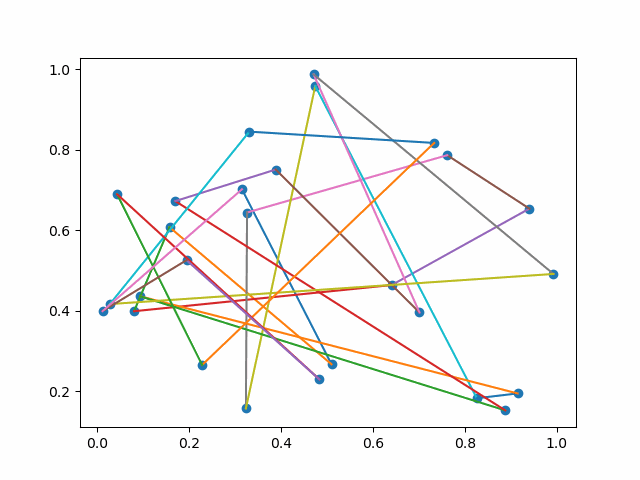

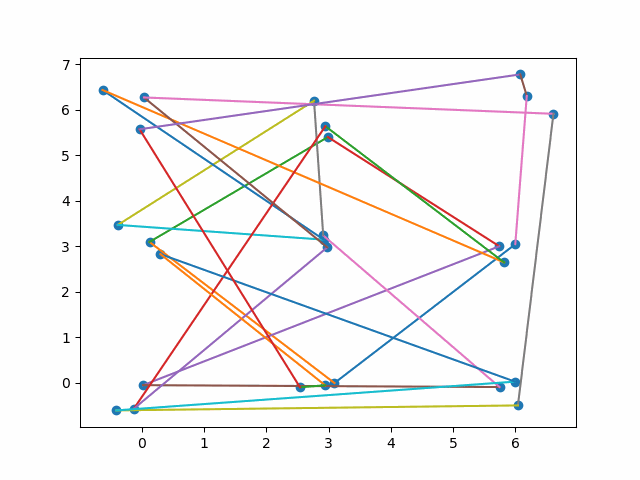

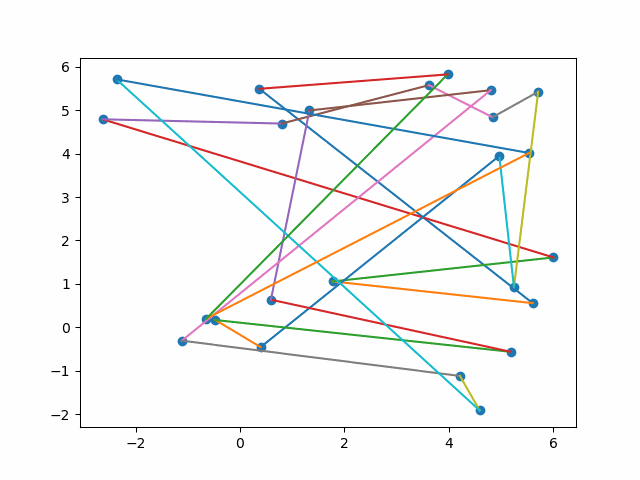

In [20]:
for init_func in init_functions:
    points = init_func(n)
    _, _, _, logs = vis_simulated_annealing_tsp(points, t_func = t_func, modify_func = modify_func)
    display_gif()

In [43]:
n = 30
t_func = lambda x: 0.9999 * x
init_func = init_points_random
modify_func = modify_solution_arbitrary

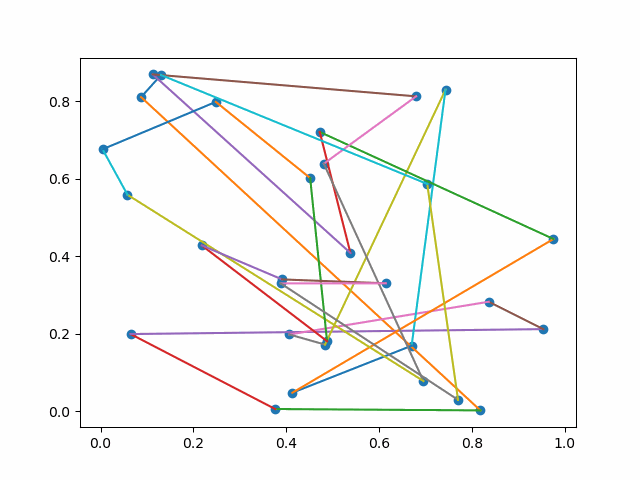

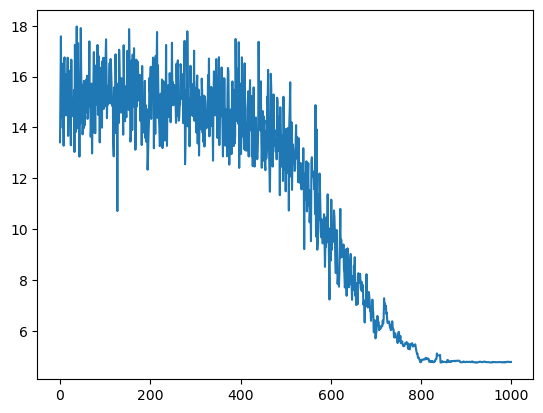

In [44]:
points = init_func(n)
_, _, _, logs = vis_simulated_annealing_tsp(points, t_func = t_func, modify_func = modify_func)
display_gif()
draw_cost_timeline(logs)

# Benchmark

In [38]:
t_functions = [
    lambda x: 0.999 * x,
    lambda x: 0.99 * x,
    lambda x: 0.95 * x,
    lambda x: x - 0.01,
]

In [39]:
init_functions = [
    init_points_random,
    init_connected_groups,
    init_normal_distributions
]

In [40]:
modify_functions = [
    modify_solution_arbitrary,
    modify_solution_consecutive
]

In [41]:
n_values = [
    10,
    18,
    30,
    45,
    60
]

In [45]:
for n in n_values:
    print("n: {n}".format(n = n))
    for init_func in init_functions:
        points_buff = init_func(n)
        print("\tPoints initialization: {init_func_name}".format(init_func_name = init_func.__name__))
        for modify_func in modify_functions:
            print("\t\tSolution modification: {modify_func_name}".format(modify_func_name = modify_func.__name__))
            for t_func in t_functions:
                points = np.copy(points_buff)
                time1 = time.time()
                historically_best_cost, _, _, _ = simulated_annealing_tsp(points, t_func = t_func, modify_func = modify_func)
                time2 = time.time()

                print("\t\t\tTime: {time_diff}, cost: {cost}".format(time_diff = time2 - time1, cost = historically_best_cost[0]))

n: 10
	Points initialization: init_points_random
		Solution modification: modify_solution_arbitrary
			Time: 7.243378162384033, cost: 2.6088059796797105
			Time: 0.45800137519836426, cost: 2.6088059796802754
			Time: 0.08499574661254883, cost: 2.6088059796803393
			Time: 2.1334304809570312, cost: 2.752660138115796
		Solution modification: modify_solution_consecutive
			Time: 5.296142816543579, cost: 2.608805979679637
			Time: 0.3909733295440674, cost: 2.9014505461960614
			Time: 0.06999993324279785, cost: 4.01483128132279
			Time: 1.7154135704040527, cost: 2.899825675967536
	Points initialization: init_connected_groups
		Solution modification: modify_solution_arbitrary
			Time: 6.0835206508636475, cost: 25.40810509333373
			Time: 0.49202871322631836, cost: 25.408105093333972
			Time: 0.09598278999328613, cost: 25.40810509333425
			Time: 2.3804776668548584, cost: 25.408105093331624
		Solution modification: modify_solution_consecutive
			Time: 5.498734712600708, cost: 25.408105093333234


# Summary

Porównanie różnych funkcji spadku temperatury oraz modyfikacji prowadzi do następujących wniosków:

- najlepiej sprawdza się funkcja spadku temperatury $T_{i + 1} = 0.999 * T_{i}$, wymaga jednak najwięcej czasu. Temperatura spada znacznie wolniej, w związku z czym wykonuje się znacznie więcej iteracji algorytmu.
- obiecujące rezultaty daje funkcja spadku temperatury $T_{i + 1} = 0.99 * T_{i}$, jakość rozwiązania nie odbiega znacząco od najlepszego z wyznaczonych, przy czym czas działania algorytmu jest około $10$ razy krótszy.

- metoda Consecutive Swap sprawdza się zdecydowanie gorzej niż metoda Arbitrary Swap, rozwiązania uzyskane tą metodą dla tych samych układów punktów są średnio około $2$ razy gorsze

- w większości przypadków, algorytm wyżarzania znacząco niweluje ilość niepotrzebnych przecięć krawędzi, a wizualizacja otrzymanych rozwiązań wygląda obiecująco.